In [1]:
import geopandas as gpd
import matplotlib as plt
from geopandas.tools import sjoin

In [2]:
ortsteile_df = gpd.read_file('ortsteile.geojson')
ortsteile_df

,gml_id,spatial_name,spatial_alias,spatial_type,geometry
0,re_ortsteil.0101,0101,Mitte,Polygon,"POLYGON ((390887.827 5821875.159, 390873.482 5..."
1,re_ortsteil.0102,0102,Moabit,Polygon,"POLYGON ((387338.941 5822384.132, 387336.697 5..."
2,re_ortsteil.0103,0103,Hansaviertel,Polygon,"POLYGON ((387868.810 5819944.731, 387870.303 5..."
3,re_ortsteil.0104,0104,Tiergarten,Polygon,"POLYGON ((389823.704 5820142.165, 389822.801 5..."
4,re_ortsteil.0105,0105,Wedding,Polygon,"POLYGON ((388825.025 5824733.214, 388824.600 5..."
...,...,...,...,...,...
91,re_ortsteil.1207,1207,Waidmannslust,Polygon,"POLYGON ((387563.534 5830069.773, 387552.777 5..."
92,re_ortsteil.1208,1208,Lübars,Polygon,"POLYGON ((389576.390 5831600.990, 389570.773 5..."
93,re_ortsteil.1209,1209,Wittenau,Polygon,"POLYGON ((387599.640 5829038.168, 387611.912 5..."
94,re_ortsteil.1210,1210,Märkisches,Polygon,"POLYGON ((389587.174 5829760.869, 389584.328 5..."


In [3]:
karte_df = gpd.read_file('karte.geojson')
karte_df

,gml_id,FLALLE,STR_FLGES,BEZ,BEZIRK,STAT,PRG,PRG_NAME,BZR,BZR_NAME,PLR,PLR_NAME,geometry
0,s_ISU5_2015_UA.0401090161000000,194431.0,24391.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((394862.511 5821917.607, 394870.946 5..."
1,s_ISU5_2015_UA.0401090171000000,16605.0,5668.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((395663.219 5821249.211, 395723.397 5..."
2,s_ISU5_2015_UA.0401090181000000,7264.0,3720.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((395627.552 5821169.347, 395655.761 5..."
3,s_ISU5_2015_UA.0401090191000000,109611.0,21853.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((394754.286 5821803.367, 394918.729 5..."
4,s_ISU5_2015_UA.0401090201000000,101452.0,6613.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061435,Conrad-Blenkle-Straße,"POLYGON ((394550.669 5821404.393, 394681.395 5..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
25347,s_ISU5_2015_UA.2101870341000000,17646.0,3851.0,10.0,Marzahn-Hellersdorf,187,1003,Biesdorf,100307,Biesdorf,10030726,Alt-Biesdorf,"POLYGON ((401616.998 5818495.114, 401765.081 5..."
25348,s_ISU5_2015_UA.2101870351000000,12228.0,4085.0,10.0,Marzahn-Hellersdorf,187,1003,Biesdorf,100307,Biesdorf,10030726,Alt-Biesdorf,"POLYGON ((401812.966 5818629.597, 401786.424 5..."
25349,s_ISU5_2015_UA.2101870371000000,65967.0,13644.0,10.0,Marzahn-Hellersdorf,187,1003,Biesdorf,100307,Biesdorf,10030726,Alt-Biesdorf,"POLYGON ((401875.901 5818470.758, 402133.378 5..."
25350,s_ISU5_2015_UA.2101870381000000,18886.0,5669.0,10.0,Marzahn-Hellersdorf,187,1003,Biesdorf,100307,Biesdorf,10030726,Alt-Biesdorf,"POLYGON ((402392.014 5818315.010, 402535.539 5..."


In [4]:
beleucht_df = gpd.read_file('beleucht.geojson')
beleucht_df

,gml_id,LEUCHTSTELLE,KURZNUMMER,BETRIEBSART,STATUS,BEZIRK,ORTSTEIL,STRASSE,EAST,NORTH,LEUCHTENTYP,geometry
0,s_oeffbeleucht.33123,02211-2110008-00,0008,Strom,In Betrieb,Spandau (REG C),Kladow,Jägerallee,372438.3163,5814483.635,Lichtmast mit Ansatzleuchte,POINT (372438.316 5814483.635)
1,s_oeffbeleucht.33124,02211-2110009-00,0009,Strom,In Betrieb,Spandau (REG C),Kladow,Jägerallee,372426.9082,5814451.792,Lichtmast mit Ansatzleuchte,POINT (372426.908 5814451.792)
2,s_oeffbeleucht.33125,02211-2110010-00,0010,Strom,In Betrieb,Spandau (REG C),Kladow,Jägerallee,372431.6264,5814423.142,Lichtmast mit Ansatzleuchte,POINT (372431.626 5814423.142)
3,s_oeffbeleucht.33126,02211-2110011-00,0011,Strom,In Betrieb,Spandau (REG C),Kladow,Jägerallee,372440.9318,5814390.779,Lichtmast mit Ansatzleuchte,POINT (372440.932 5814390.779)
4,s_oeffbeleucht.33127,02211-2110012-00,0012,Strom,In Betrieb,Spandau (REG C),Kladow,Jägerallee,372453.2643,5814363.783,Lichtmast mit Ansatzleuchte,POINT (372453.264 5814363.783)
...,...,...,...,...,...,...,...,...,...,...,...,...
210366,s_oeffbeleucht.258909,03202-2110018-00,0018,Strom,In Betrieb,Spandau (REG C),Spandau,Neue Bergstraße,378108.3116,5823713.827,Lichtmast mit Aufsatzleuchte,POINT (378108.312 5823713.827)
210367,s_oeffbeleucht.258910,03202-2110019-00,0019,Strom,In Betrieb,Spandau (REG C),Spandau,Neue Bergstraße,378094.0616,5823702.452,Lichtmast mit Aufsatzleuchte,POINT (378094.062 5823702.452)
210368,s_oeffbeleucht.258911,03202-2110020-00,0020,Strom,In Betrieb,Spandau (REG C),Spandau,Neue Bergstraße,378073.5779,5823701.812,Lichtmast mit Aufsatzleuchte,POINT (378073.578 5823701.812)
210369,s_oeffbeleucht.258912,03202-2110021-00,0021,Strom,In Betrieb,Spandau (REG C),Spandau,Neue Bergstraße,378059.9366,5823707.952,Lichtmast mit Aufsatzleuchte,POINT (378059.937 5823707.952)


In [5]:
typ_df = gpd.read_file('typ.geojson')
typ_df

,gml_id,BIOTOP_ID,BT_CODE,BT_NAME,BT_LEG,BFN_CODE,ZBT_CODE,BBT_CODE,SCHUTZ_GES,BT_WERT,...,LRT_NAME,LRT_ZUSTA,LRT_KOMPL,BOGEN_ID,KART_JAHR,PRJ_ID,PRJ_TITEL,DAT_QUELLE,DAT_METHOD,geometry
0,s_fb_berlinbtk.SD1276015,SD1276015,01000,Fließgewässer,1,23.,None,None,3,-1,...,None,None,3,None,None,None,None,S,S_Gewässer,"POLYGON ((373878.291 5823124.698, 373876.630 5..."
1,s_fb_berlinbtk.SD1276021,SD1276021,01000,Fließgewässer,1,23.,None,None,3,-1,...,None,None,3,None,None,None,None,S,S_Gewässer,"POLYGON ((377387.250 5821451.963, 377387.591 5..."
2,s_fb_berlinbtk.SD1276024,SD1276024,01000,Fließgewässer,1,23.,None,None,3,-1,...,None,None,3,None,None,None,None,S,S_Gewässer,"POLYGON ((377053.903 5821392.762, 377053.882 5..."
3,s_fb_berlinbtk.SD1276027,SD1276027,01000,Fließgewässer,1,23.,None,None,3,-1,...,None,None,3,None,None,None,None,S,S_Gewässer,"POLYGON ((377643.322 5810868.289, 377645.257 5..."
4,s_fb_berlinbtk.SD1276033,SD1276033,01000,Fließgewässer,1,23.,None,None,3,-1,...,None,None,3,None,None,None,None,S,S_Gewässer,"POLYGON ((385661.856 5827958.611, 385640.907 5..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103326,s_fb_berlinbtk.1002P0942,1002P0942,12930,Gebäudeinnenräume/ künstliche Höhlen mit Bedeu...,20,53.01,None,None,0,-1,...,None,None,0,None,2010,1002,LSG Mauergrünzug,P,P_Luftbild,POINT (389496.435 5826701.824)
103327,s_fb_berlinbtk.1002P0943,1002P0943,12930,Gebäudeinnenräume/ künstliche Höhlen mit Bedeu...,20,53.01,None,None,0,-1,...,None,None,0,None,2010,1002,LSG Mauergrünzug,P,P_Luftbild,POINT (389529.622 5826652.381)
103328,s_fb_berlinbtk.1002P0944,1002P0944,12930,Gebäudeinnenräume/ künstliche Höhlen mit Bedeu...,20,53.01,None,None,0,-1,...,None,None,0,None,2010,1002,LSG Mauergrünzug,P,P_Luftbild,POINT (389676.007 5826517.709)
103329,s_fb_berlinbtk.1002P0945,1002P0945,12930,Gebäudeinnenräume/ künstliche Höhlen mit Bedeu...,20,53.01,None,None,0,-1,...,None,None,0,None,2010,1002,LSG Mauergrünzug,P,P_Luftbild,POINT (389692.795 5826478.829)


In [6]:
emission_df = gpd.read_file('emission.geojson')
emission_df

,gml_id,IDNR_1KM,X_MAX,X_MIN,Y_MAX,Y_MIN,AREA,NOX_H_15,NOX_I_15,NOX_V_GN15,...,PM10_VHN15,PM10_VNN15,PM10_GE_15,PM2_5_H_15,PM2_5_I_15,PM25_VGN15,PM25_VHN15,PM25_VNN15,PM25_GE15,geometry
0,s03_12_2emissionen.117,38485828.0,385800.0,384800.0,5829700.0,5828700.0,1000000.0,2.43,0.00,4.96,...,0.37,0.06,0.73,0.27,0.0,0.22,0.18,0.04,1.0,"POLYGON ((384800.000 5828700.000, 385800.000 5..."
1,s03_12_2emissionen.118,38585828.0,386800.0,385800.0,5829700.0,5828700.0,1000000.0,1.79,52.52,6.37,...,0.44,0.12,0.86,0.24,0.0,0.30,0.21,0.08,1.0,"POLYGON ((385800.000 5828700.000, 386800.000 5..."
2,s03_12_2emissionen.119,38685828.0,387800.0,386800.0,5829700.0,5828700.0,1000000.0,1.73,30.99,9.51,...,0.73,0.12,1.26,0.35,0.0,0.42,0.34,0.08,1.0,"POLYGON ((386800.000 5828700.000, 387800.000 5..."
3,s03_12_2emissionen.120,38785828.0,388800.0,387800.0,5829700.0,5828700.0,1000000.0,1.35,0.00,7.03,...,0.30,0.16,0.83,0.35,0.0,0.29,0.18,0.10,1.0,"POLYGON ((387800.000 5828700.000, 388800.000 5..."
4,s03_12_2emissionen.121,38885828.0,389800.0,388800.0,5829700.0,5828700.0,1000000.0,0.64,0.00,10.65,...,0.63,0.10,0.88,0.14,0.0,0.35,0.28,0.06,0.0,"POLYGON ((388800.000 5828700.000, 389800.000 5..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1019,s03_12_2emissionen.1020,40885800.0,409800.0,408800.0,5801700.0,5800700.0,1000000.0,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,"POLYGON ((408800.000 5800700.000, 409800.000 5..."
1020,s03_12_2emissionen.1021,40685799.0,407800.0,406800.0,5800700.0,5799700.0,1000000.0,0.43,0.00,0.02,...,0.00,0.00,0.18,0.17,0.0,0.00,0.00,0.00,0.0,"POLYGON ((406800.000 5799700.000, 407800.000 5..."
1021,s03_12_2emissionen.1022,40785799.0,408800.0,407800.0,5800700.0,5799700.0,1000000.0,0.14,0.00,0.01,...,0.00,0.00,0.06,0.05,0.0,0.00,0.00,0.00,0.0,"POLYGON ((407800.000 5799700.000, 408800.000 5..."
1022,s03_12_2emissionen.1023,40685798.0,407800.0,406800.0,5799700.0,5798700.0,1000000.0,0.00,0.00,0.01,...,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,"POLYGON ((406800.000 5799700.000, 406800.000 5..."


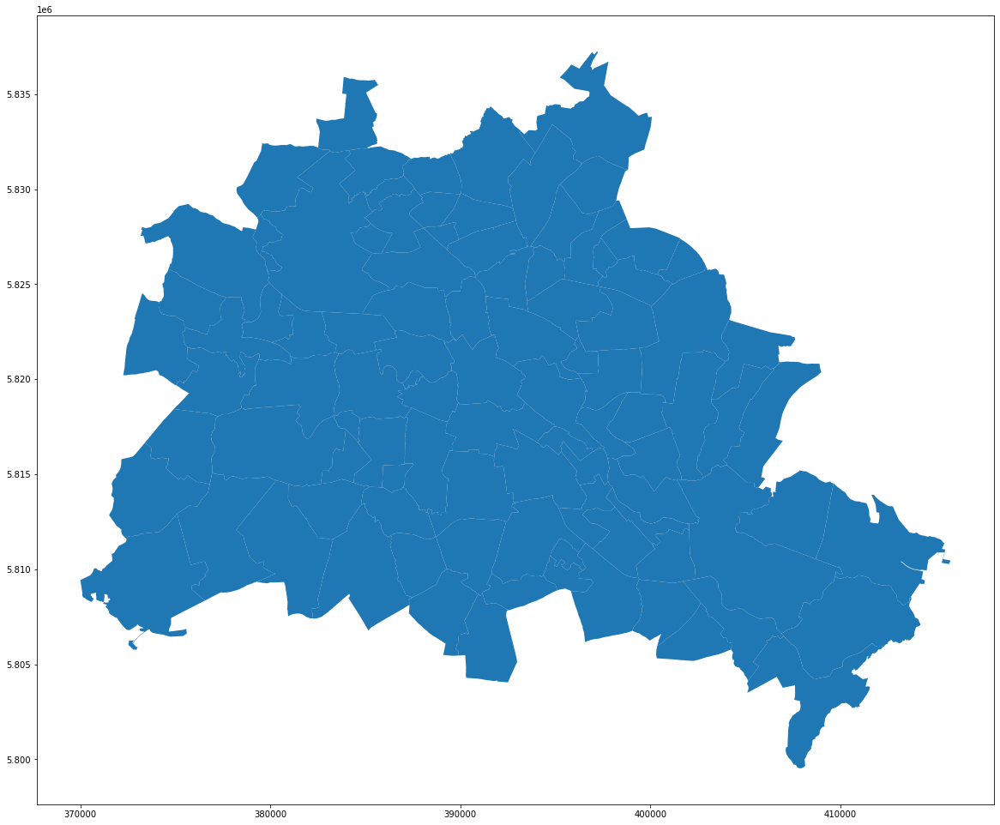

In [7]:
ortsteile_df.plot(figsize=(20, 20))

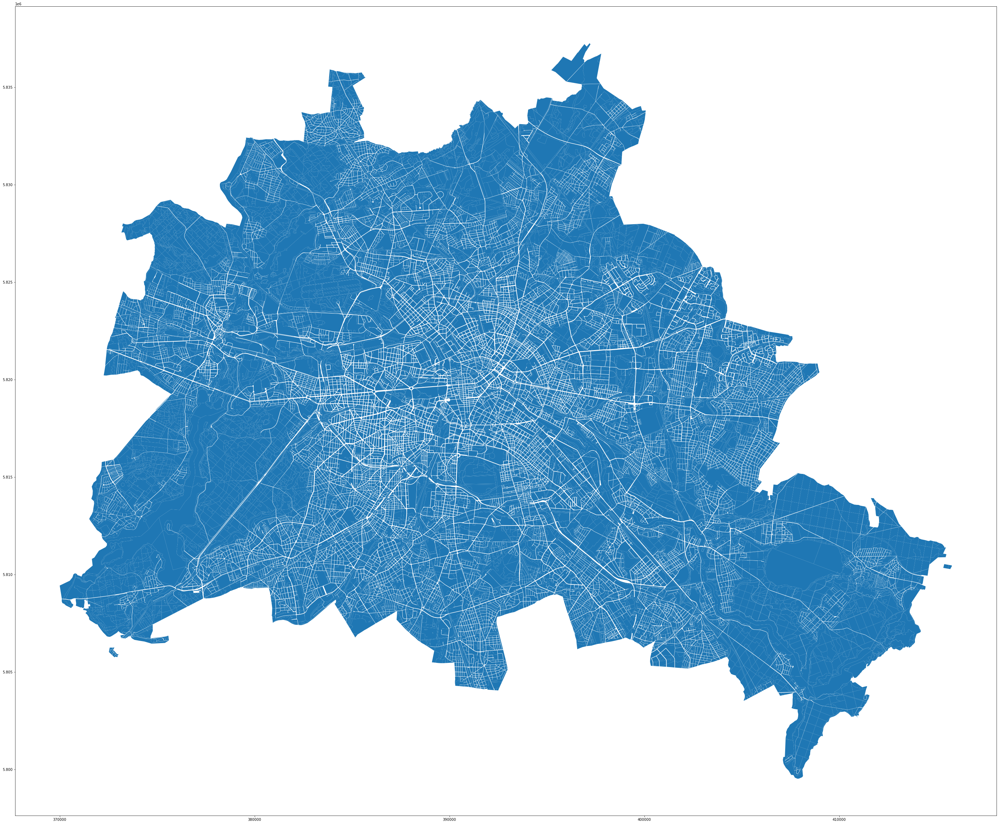

In [8]:
karte_df.plot(figsize=(50, 50))

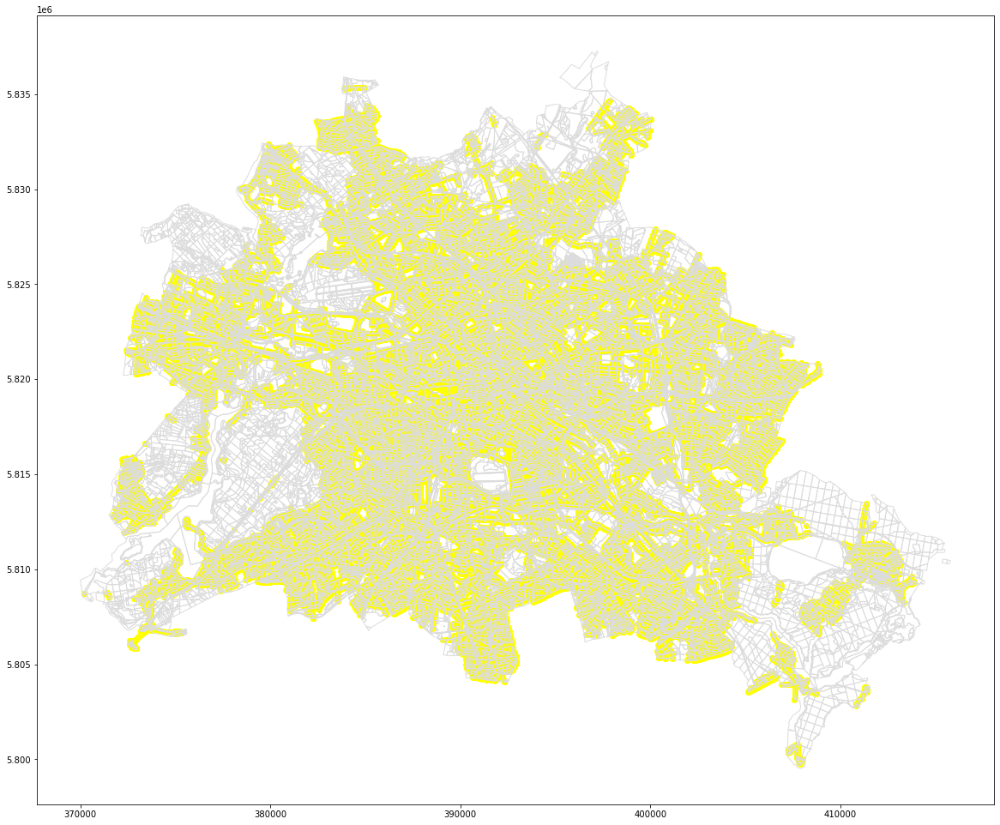

In [9]:
ax = karte_df.plot(figsize=(20, 20), color='none', edgecolor='gainsboro', zorder=3)

# Add beleucht_df to the base map
beleucht_df.plot(color='yellow', ax=ax)

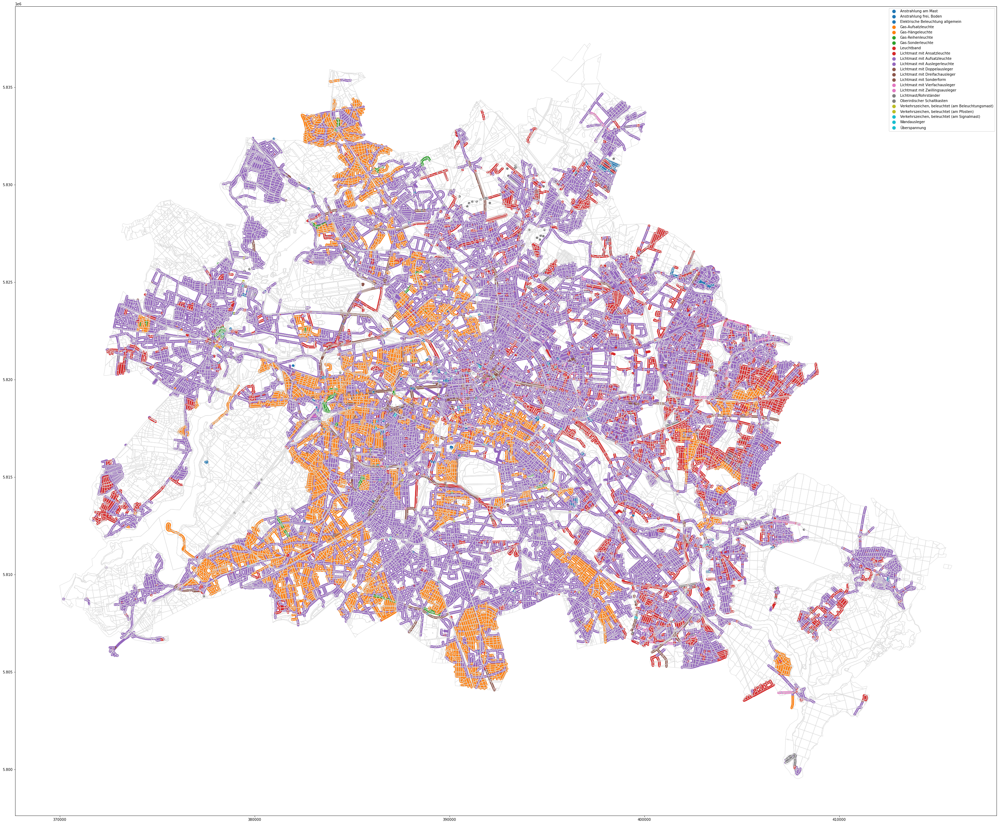

In [10]:
ax = karte_df.plot(figsize=(50, 50), color='none', edgecolor='gainsboro', zorder=3)

beleucht_fig = beleucht_df.plot(column='LEUCHTENTYP', ax=ax, legend=True)

In [11]:
beleucht_fig.get_figure().savefig('beleucht.png')

In [12]:
# Add (beleucht, typ and emission)_df to the base map
beleucht_df.plot(alpha = 0.5, color='lightgreen', ax=ax)
typ_df.plot(alpha = 0.5, facecolor='darkorange', ax=ax, edgecolor='k') 
emission_df.plot(alpha = 0.5, color='whitesmoke', ax=ax,  edgecolor='k')

<Figure size 432x288 with 0 Axes>

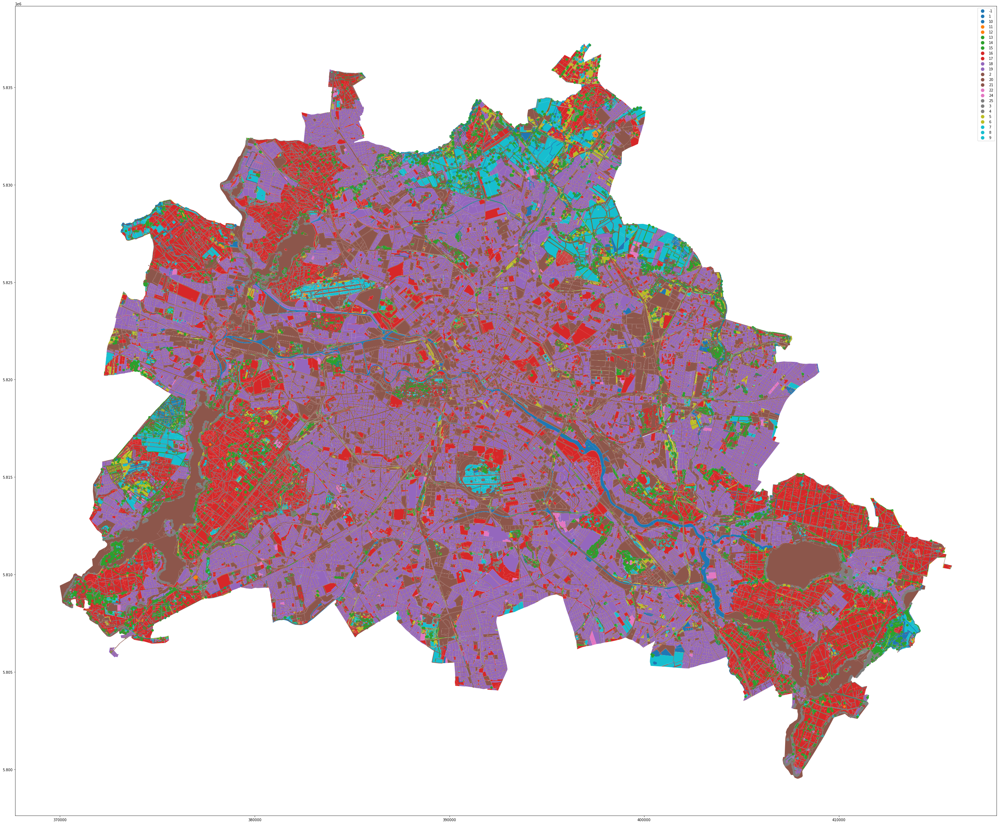

In [13]:
typ_df.plot(column='BT_LEG', figsize=(50, 50), legend=True)

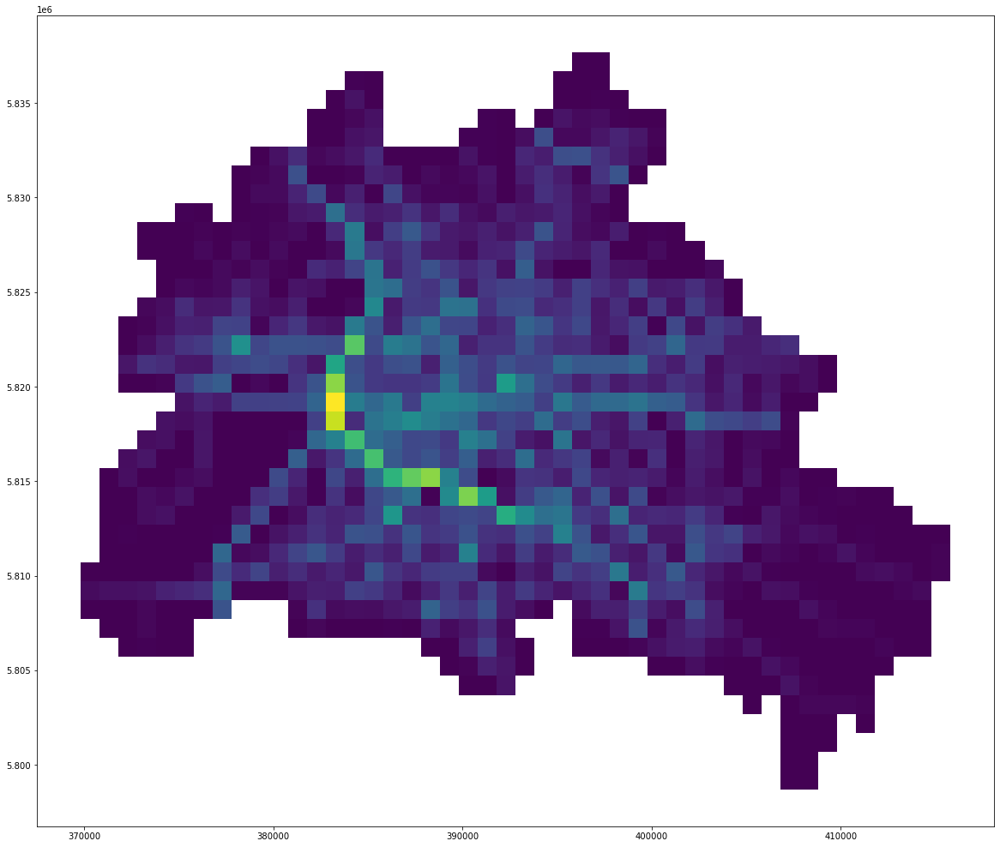

In [14]:
emission_df.plot(figsize=(20, 20), column="PM10_VHN15")

In [15]:
#How many square km per street
karte_df.STR_FLGES.value_counts()

0.0        2440
1.0          39
1990.0       11
2324.0       10
1880.0        9
           ... 
2724.0        1
8240.0        1
13691.0       1
10093.0       1
10810.0       1
Name: STR_FLGES, Length: 9092, dtype: int64

In [16]:
karte_df.BEZIRK.value_counts()

Treptow-Köpenick              3513
Steglitz-Zehlendorf           2939
Pankow                        2885
Spandau                       2545
Reinickendorf                 2446
Marzahn-Hellersdorf           2068
Charlottenburg-Wilmersdorf    1962
Tempelhof-Schöneberg          1745
Neukölln                      1534
Lichtenberg                   1502
Mitte                         1443
Friedrichshain-Kreuzberg       770
Name: BEZIRK, dtype: int64

In [17]:
# Calculate the area (in square kilometers) of each polygon in the GeoDataFrame 
karte_df.loc[:, "AREA"] = karte_df.geometry.area / 10**6

print("Area Berlin: {} square kilometers".format(karte_df.AREA.sum()))
print("CRS:", karte_df.crs)
karte_df.head()

Area Berlin: 793.8448747346648 square kilometers
CRS: epsg:4326


,gml_id,FLALLE,STR_FLGES,BEZ,BEZIRK,STAT,PRG,PRG_NAME,BZR,BZR_NAME,PLR,PLR_NAME,geometry,AREA
0,s_ISU5_2015_UA.0401090161000000,194431.0,24391.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((394862.511 5821917.607, 394870.946 5...",0.194325
1,s_ISU5_2015_UA.0401090171000000,16605.0,5668.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((395663.219 5821249.211, 395723.397 5...",0.016596
2,s_ISU5_2015_UA.0401090181000000,7264.0,3720.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((395627.552 5821169.347, 395655.761 5...",0.007260
3,s_ISU5_2015_UA.0401090191000000,109611.0,21853.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061430,Volkspark Prenzlauer Berg,"POLYGON ((394754.286 5821803.367, 394918.729 5...",0.109551
4,s_ISU5_2015_UA.0401090201000000,101452.0,6613.0,3.0,Pankow,109,0306,Nördlicher Prenzl. Berg,030614,Prenzlauer Berg Ost,03061435,Conrad-Blenkle-Straße,"POLYGON ((394550.669 5821404.393, 394681.395 5...",0.101397


In [18]:
# Calculate the area (in square kilometers) of each polygon in the GeoDataFrame 
emission_df.loc[:, "AREA"] = emission_df.geometry.area / 10**6

print("Area of Berlin: {} square kilometers".format(emission_df.AREA.sum()))
print("CRS:", emission_df.crs)
emission_df.head()

Area of Berlin: 1024.0 square kilometers
CRS: epsg:4326


,gml_id,IDNR_1KM,X_MAX,X_MIN,Y_MAX,Y_MIN,AREA,NOX_H_15,NOX_I_15,NOX_V_GN15,...,PM10_VHN15,PM10_VNN15,PM10_GE_15,PM2_5_H_15,PM2_5_I_15,PM25_VGN15,PM25_VHN15,PM25_VNN15,PM25_GE15,geometry
0,s03_12_2emissionen.117,38485828.0,385800.0,384800.0,5829700.0,5828700.0,1.0,2.43,0.00,4.96,...,0.37,0.06,0.73,0.27,0.0,0.22,0.18,0.04,1.0,"POLYGON ((384800.000 5828700.000, 385800.000 5..."
1,s03_12_2emissionen.118,38585828.0,386800.0,385800.0,5829700.0,5828700.0,1.0,1.79,52.52,6.37,...,0.44,0.12,0.86,0.24,0.0,0.30,0.21,0.08,1.0,"POLYGON ((385800.000 5828700.000, 386800.000 5..."
2,s03_12_2emissionen.119,38685828.0,387800.0,386800.0,5829700.0,5828700.0,1.0,1.73,30.99,9.51,...,0.73,0.12,1.26,0.35,0.0,0.42,0.34,0.08,1.0,"POLYGON ((386800.000 5828700.000, 387800.000 5..."
3,s03_12_2emissionen.120,38785828.0,388800.0,387800.0,5829700.0,5828700.0,1.0,1.35,0.00,7.03,...,0.30,0.16,0.83,0.35,0.0,0.29,0.18,0.10,1.0,"POLYGON ((387800.000 5828700.000, 388800.000 5..."
4,s03_12_2emissionen.121,38885828.0,389800.0,388800.0,5829700.0,5828700.0,1.0,0.64,0.00,10.65,...,0.63,0.10,0.88,0.14,0.0,0.35,0.28,0.06,0.0,"POLYGON ((388800.000 5828700.000, 389800.000 5..."


In the code cell above, the CRS of the regions GeoDataFrame is set to EPSG 32630 (a "Mercator" projection).

FLALLE = Flächengröße [m²]
STR_FLGES = Straßenfläche [m²]
BEZ = Bezirksnummer
BEZIRK = Bezirksname
STAT = N. for Statistics
PRG = Prognoseräume
PRG_NAME = Prognoseräume Name
BZR = Bezirksregionen
BZR_NAME = Bezirksregionen Name  
PLR = Planungsräume
PLR_NAME = Planungsräume Name


In [19]:
typ_df.info()
typ_df.size
typ_df.shape

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 103331 entries, 0 to 103330
Data columns (total 21 columns):
 #   Column      Non-Null Count   Dtype   
---  ------      --------------   -----   
 0   gml_id      103331 non-null  object  
 1   BIOTOP_ID   103331 non-null  object  
 2   BT_CODE     103331 non-null  object  
 3   BT_NAME     103331 non-null  object  
 4   BT_LEG      103331 non-null  object  
 5   BFN_CODE    103331 non-null  object  
 6   ZBT_CODE    12450 non-null   object  
 7   BBT_CODE    10312 non-null   object  
 8   SCHUTZ_GES  103331 non-null  object  
 9   BT_WERT     103331 non-null  object  
 10  LRT_CODE    5955 non-null    object  
 11  LRT_NAME    5955 non-null    object  
 12  LRT_ZUSTA   2210 non-null    object  
 13  LRT_KOMPL   103331 non-null  object  
 14  BOGEN_ID    10552 non-null   object  
 15  KART_JAHR   72889 non-null   object  
 16  PRJ_ID      72889 non-null   object  
 17  PRJ_TITEL   72889 non-null   object  
 18  DAT_QUELLE  1033

(103331, 21)

In [20]:
emission_df.info()
emission_df.size
emission_df.shape
emission_df.describe()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1024 entries, 0 to 1023
Data columns (total 26 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   gml_id      1024 non-null   object  
 1   IDNR_1KM    1024 non-null   float64 
 2   X_MAX       1024 non-null   float64 
 3   X_MIN       1024 non-null   float64 
 4   Y_MAX       1024 non-null   float64 
 5   Y_MIN       1024 non-null   float64 
 6   AREA        1024 non-null   float64 
 7   NOX_H_15    1024 non-null   float64 
 8   NOX_I_15    1024 non-null   float64 
 9   NOX_V_GN15  1024 non-null   float64 
 10  NOX_V_HN15  1024 non-null   float64 
 11  NOX_V_NN15  1024 non-null   float64 
 12  NOX_GE_15   1024 non-null   float64 
 13  PM10_H_15   1024 non-null   float64 
 14  PM10_I_15   1024 non-null   float64 
 15  PM10_VGN15  1024 non-null   float64 
 16  PM10_VHN15  1024 non-null   float64 
 17  PM10_VNN15  1024 non-null   float64 
 18  PM10_GE_15  1024 non-null   float64 
 19

,IDNR_1KM,X_MAX,X_MIN,Y_MAX,Y_MIN,AREA,NOX_H_15,NOX_I_15,NOX_V_GN15,NOX_V_HN15,...,PM10_VGN15,PM10_VHN15,PM10_VNN15,PM10_GE_15,PM2_5_H_15,PM2_5_I_15,PM25_VGN15,PM25_VHN15,PM25_VNN15,PM25_GE15
count,1.024000e+03,1024.000000,1024.000000,1.024000e+03,1.024000e+03,1024.0,1024.000000,1024.000000,1024.000000,1024.000000,...,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000,1024.000000
mean,3.912703e+07,392212.109375,391212.109375,5.818446e+06,5.817446e+06,1.0,1.943613,6.634482,6.739385,5.534268,...,0.606592,0.529170,0.074248,0.980068,0.219004,0.075752,0.307852,0.256670,0.048018,0.574219
std,1.119313e+06,11193.145239,11193.145239,8.380375e+03,8.380375e+03,0.0,2.524935,74.274197,8.064260,6.993032,...,0.737712,0.671786,0.089881,1.880769,0.372980,0.915044,0.375436,0.331082,0.058743,1.189050
min,3.698581e+07,370800.000000,369800.000000,5.799700e+06,5.798700e+06,1.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.818583e+07,382800.000000,381800.000000,5.811700e+06,5.810700e+06,1.0,0.020000,0.000000,0.550000,0.227500,...,0.030000,0.010000,0.010000,0.070000,0.000000,0.000000,0.020000,0.010000,0.010000,0.000000
50%,3.908583e+07,391800.000000,390800.000000,5.817700e+06,5.816700e+06,1.0,0.970000,0.000000,3.930000,3.110000,...,0.350000,0.290000,0.040000,0.530000,0.080000,0.000000,0.180000,0.140000,0.030000,0.000000
75%,3.998582e+07,400800.000000,399800.000000,5.824700e+06,5.823700e+06,1.0,3.070000,0.000000,10.280000,8.577500,...,0.950000,0.820000,0.110000,1.300000,0.280000,0.000000,0.470000,0.390000,0.070000,1.000000
max,4.148581e+07,415800.000000,414800.000000,5.837700e+06,5.836700e+06,1.0,16.150000,1792.240000,60.140000,53.700000,...,5.450000,5.030000,0.620000,33.920000,3.560000,19.360000,2.840000,2.560000,0.410000,20.000000


In [21]:
karte_df.dtypes

gml_id         object
FLALLE        float64
STR_FLGES     float64
BEZ           float64
BEZIRK         object
STAT           object
PRG            object
PRG_NAME       object
BZR            object
BZR_NAME       object
PLR            object
PLR_NAME       object
geometry     geometry
AREA          float64
dtype: object

In [22]:
beleucht_df.dtypes

gml_id            object
LEUCHTSTELLE      object
KURZNUMMER        object
BETRIEBSART       object
STATUS            object
BEZIRK            object
ORTSTEIL          object
STRASSE           object
EAST             float64
NORTH            float64
LEUCHTENTYP       object
geometry        geometry
dtype: object

In [23]:
typ_df.dtypes

gml_id          object
BIOTOP_ID       object
BT_CODE         object
BT_NAME         object
BT_LEG          object
BFN_CODE        object
ZBT_CODE        object
BBT_CODE        object
SCHUTZ_GES      object
BT_WERT         object
LRT_CODE        object
LRT_NAME        object
LRT_ZUSTA       object
LRT_KOMPL       object
BOGEN_ID        object
KART_JAHR       object
PRJ_ID          object
PRJ_TITEL       object
DAT_QUELLE      object
DAT_METHOD      object
geometry      geometry
dtype: object

In [24]:
emission_df.dtypes

gml_id          object
IDNR_1KM       float64
X_MAX          float64
X_MIN          float64
Y_MAX          float64
Y_MIN          float64
AREA           float64
NOX_H_15       float64
NOX_I_15       float64
NOX_V_GN15     float64
NOX_V_HN15     float64
NOX_V_NN15     float64
NOX_GE_15      float64
PM10_H_15      float64
PM10_I_15      float64
PM10_VGN15     float64
PM10_VHN15     float64
PM10_VNN15     float64
PM10_GE_15     float64
PM2_5_H_15     float64
PM2_5_I_15     float64
PM25_VGN15     float64
PM25_VHN15     float64
PM25_VNN15     float64
PM25_GE15      float64
geometry      geometry
dtype: object

In [25]:
emission_df.PM10_H_15.value_counts()

0.00    284
0.01     79
0.02     35
0.04     25
0.05     25
       ... 
1.10      1
0.81      1
1.56      1
1.07      1
1.73      1
Name: PM10_H_15, Length: 126, dtype: int64

In [26]:
ref_df = ortsteile_df[['spatial_name', 'spatial_alias', 'geometry']]

In [27]:
ref_df

,spatial_name,spatial_alias,geometry
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5..."
1,0102,Moabit,"POLYGON ((387338.941 5822384.132, 387336.697 5..."
2,0103,Hansaviertel,"POLYGON ((387868.810 5819944.731, 387870.303 5..."
3,0104,Tiergarten,"POLYGON ((389823.704 5820142.165, 389822.801 5..."
4,0105,Wedding,"POLYGON ((388825.025 5824733.214, 388824.600 5..."
...,...,...,...
91,1207,Waidmannslust,"POLYGON ((387563.534 5830069.773, 387552.777 5..."
92,1208,Lübars,"POLYGON ((389576.390 5831600.990, 389570.773 5..."
93,1209,Wittenau,"POLYGON ((387599.640 5829038.168, 387611.912 5..."
94,1210,Märkisches,"POLYGON ((389587.174 5829760.869, 389584.328 5..."


In [28]:
# Calculate the area (in square kilometers) of each polygon in the GeoDataFrame 
ref_df.loc[:, "AREA"] = ref_df.geometry.area / 10**6

print("Area of Prenzlauer Berg: {} square kilometers".format(ref_df.AREA.sum()))
print("CRS:", ref_df.crs)
ref_df.head()

Area of Prenzlauer Berg: 890.6661085809144 square kilometers
CRS: epsg:4326


C:\Users\Marfisa\Anaconda3\envs\forge\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Marfisa\Anaconda3\envs\forge\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


,spatial_name,spatial_alias,geometry,AREA
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879
1,0102,Moabit,"POLYGON ((387338.941 5822384.132, 387336.697 5...",7.705491
2,0103,Hansaviertel,"POLYGON ((387868.810 5819944.731, 387870.303 5...",0.528035
3,0104,Tiergarten,"POLYGON ((389823.704 5820142.165, 389822.801 5...",5.177750
4,0105,Wedding,"POLYGON ((388825.025 5824733.214, 388824.600 5...",9.240699


In [29]:
crossing_lights_df = beleucht_df[['geometry']]

In [30]:
crossing_lights_df

,geometry
0,POINT (372438.316 5814483.635)
1,POINT (372426.908 5814451.792)
2,POINT (372431.626 5814423.142)
3,POINT (372440.932 5814390.779)
4,POINT (372453.264 5814363.783)
...,...
210366,POINT (378108.312 5823713.827)
210367,POINT (378094.062 5823702.452)
210368,POINT (378073.578 5823701.812)
210369,POINT (378059.937 5823707.952)


In [31]:
merged_df = sjoin(ref_df, crossing_lights_df, how='left')

In [32]:
merged_df

,spatial_name,spatial_alias,geometry,AREA,index_right
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879,67762
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879,78632
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879,91840
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879,117197
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879,119318
...,...,...,...,...,...
95,1211,Borsigwalde,"POLYGON ((384483.533 5827149.365, 384486.301 5...",2.042790,32604
95,1211,Borsigwalde,"POLYGON ((384483.533 5827149.365, 384486.301 5...",2.042790,39205
95,1211,Borsigwalde,"POLYGON ((384483.533 5827149.365, 384486.301 5...",2.042790,39206
95,1211,Borsigwalde,"POLYGON ((384483.533 5827149.365, 384486.301 5...",2.042790,32615


In [33]:
light_count_df = merged_df.groupby(level = 0)[['index_right']].count()
light_count_df

,index_right
0,7104
1,3468
2,355
3,2312
4,3262
...,...
91,668
92,521
93,1795
94,686


In [34]:
# changing cols index_right with rename() 
light_count_df = light_count_df.rename(columns = {"index_right": "light_count"}) 
light_count_df

,light_count
0,7104
1,3468
2,355
3,2312
4,3262
...,...
91,668
92,521
93,1795
94,686


In [35]:
result_df = ref_df.merge(light_count_df, left_index=True, right_index=True)
result_df

,spatial_name,spatial_alias,geometry,AREA,light_count
0,0101,Mitte,"POLYGON ((390887.827 5821875.159, 390873.482 5...",10.673879,7104
1,0102,Moabit,"POLYGON ((387338.941 5822384.132, 387336.697 5...",7.705491,3468
2,0103,Hansaviertel,"POLYGON ((387868.810 5819944.731, 387870.303 5...",0.528035,355
3,0104,Tiergarten,"POLYGON ((389823.704 5820142.165, 389822.801 5...",5.177750,2312
4,0105,Wedding,"POLYGON ((388825.025 5824733.214, 388824.600 5...",9.240699,3262
...,...,...,...,...,...
91,1207,Waidmannslust,"POLYGON ((387563.534 5830069.773, 387552.777 5...",2.231743,668
92,1208,Lübars,"POLYGON ((389576.390 5831600.990, 389570.773 5...",5.008444,521
93,1209,Wittenau,"POLYGON ((387599.640 5829038.168, 387611.912 5...",5.893077,1795
94,1210,Märkisches,"POLYGON ((389587.174 5829760.869, 389584.328 5...",3.244372,686


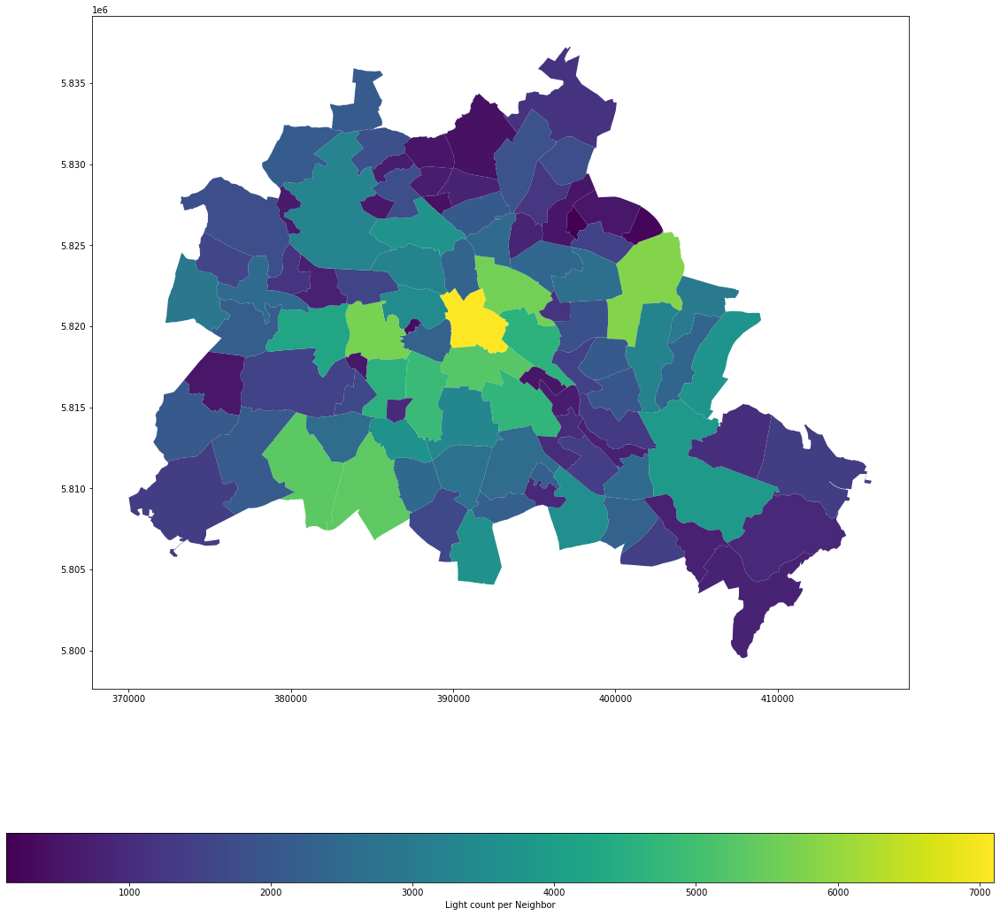

In [36]:
# Define a base map with crosslights

result_fig = result_df.plot(figsize=(20, 20), column='light_count', legend=True, legend_kwds={'label': "Light count per Neighbor",
'orientation': "horizontal"})

In [37]:
result_fig.get_figure().savefig('result.png')

In [38]:
bright_df = result_df.light_count/ result_df.geometry.area